In [17]:
import pickle
import os

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

import util

In [10]:
df = pd.read_csv('./annotation_voxel.csv')

In [22]:
import importlib
importlib.reload(util)

# util.prepare_data_3d(df, in_path='../train', out_path='./data/3d')
# util.prepare_data_3d__add_boxes_to_meta(df, out_path='./data/3d')

test_list = [fn[:-4] for fn in os.listdir('../testA/') if fn.endswith('.mhd')]
util.prepare_data_3d_for_test(test_list, in_path='../testA/', out_path='./data/testA/3d/')


100%|██████████| 145/145 [36:51<00:00, 13.85s/it]

In [15]:
meta = pickle.load(open('./data/3d/meta.pkl', 'rb'))
print(meta['636990'])

{'shape': (250, 350, 350), 'spacing': (0.68359375, 0.68359375, 5.0), 'resize_factor': (0.68359375, 0.68359375, 5.0), 'boxes': [(133, 169, 136, 148, 183, 157), (148, 152, 139, 163, 166, 149), (160, 167, 153, 190, 186, 171), (163, 145, 104, 168, 153, 113), (168, 132, 113, 173, 142, 121), (178, 169, 179, 183, 176, 191)]}


In [15]:
seriesuid = 636990
df_anno = df[df['seriesuid'] == seriesuid]
print(df_anno)

   seriesuid  coordX  coordY  coordZ  diameterX  diameterY  diameterZ  label
0     636990     214     257      28         31         21          3     32
1     636990     210     232      31         15         20          3     32
2     636990     237     258      35         27         28          6     32
3     636990     158     218      33         13         12          1      1
4     636990     171     200      34         11         15          1      1
5     636990     270     252      36         18         10          1     31


In [16]:
images_meta = pickle.load(open('./data/3d/meta.pkl', 'rb'))
image3d = np.load(f'./data/3d/{seriesuid}_data.npy')
image_label = np.load(f'./data/3d/{seriesuid}_label.npy')

In [17]:
df_anno_rs = util.resample_annotation(df_anno, images_meta[str(seriesuid)]['resize_factor'])
print(df_anno_rs)

   seriesuid  coordX  coordY  coordZ  diameterX  diameterY  diameterZ  label
0     636990     146     176     140         21         14         15     32
1     636990     144     159     155         10         14         15     32
2     636990     162     176     175         18         19         30     32
3     636990     108     149     165          9          8          5      1
4     636990     117     137     170          8         10          5      1
5     636990     185     172     180         12          7          5     31


In [18]:
util.plot_ct_as_slide(image3d, start=132, annotation_df=df_anno_rs, interval=100)

Animation size has reached 21040548 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [28]:
util.plot_ct_as_slide(image_label, start=132, annotation_df=df_anno_rs, interval=100)

In [14]:
# import importlib
# importlib.reload(util)
# util.prepare_data_2d(df, './data/train')

In [10]:
image = np.load('./data/train/636990_28.npy')

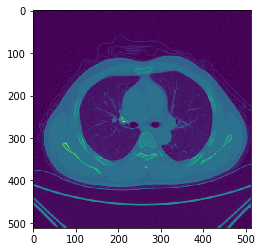

In [12]:
plt.imshow(image)

In [5]:
# %matplotlib inline
# import numpy as np
# import matplotlib.pyplot as plt
# from mpl_toolkits.mplot3d import Axes3D

# def make_ax(grid=False):
#     fig = plt.figure()
#     ax = fig.gca(projection='3d')
#     ax.set_xlabel("x")
#     ax.set_ylabel("y")
#     ax.set_zlabel("z")
#     ax.grid(grid)
#     return ax

# def explode(data):
#     shape_arr = np.array(data.shape)
#     size = shape_arr[:3]*2 - 1
#     exploded = np.zeros(np.concatenate([size, shape_arr[3:]]), dtype=data.dtype)
#     exploded[::2, ::2, ::2] = data
#     return exploded

# def expand_coordinates(indices):
#     x, y, z = indices
#     x[1::2, :, :] += 1
#     y[:, 1::2, :] += 1
#     z[:, :, 1::2] += 1
#     return x, y, z

# def plot_cube(cube, angle=320):
# #     cube = normalize(cube)

#     facecolors = plt.cm.viridis(cube)
#     facecolors[:,:,:,-1] = cube
#     facecolors = explode(facecolors)

#     filled = facecolors[:,:,:,-1] != 0
#     x, y, z = expand_coordinates(np.indices(np.array(filled.shape) + 1))

#     fig = plt.figure(figsize=(10, 10))
#     ax = fig.gca(projection='3d')
#     ax.view_init(30, angle)

#     ax.voxels(x, y, z, filled, facecolors=facecolors)
#     plt.show()

# # filled = np.array([
# #     [[1, 0, 1], [0, 0, 1], [0, 1, 0]],
# #     [[0, 1, 1], [1, 0, 0], [1, 0, 1]],
# #     [[1, 1, 0], [1, 1, 1], [0, 0, 0]]
# # ])

# # ax = make_ax()
# # colors = np.array([[['#1f77b430']*3]*3]*3)
# # colors[1,1,1] = '#ff0000ff'
# # colors = explode(colors)
# # filled = explode(np.ones((3, 3, 3)))
# # x, y, z = expand_coordinates(np.indices(np.array(filled.shape) + 1))
# # ax.voxels(x, y, z, filled, facecolors=colors, edgecolors='gray')
# # plt.show()
# plot_cube(np.ones((13,13,13)))